# **Load my Drive (connect to Colab)**

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

## Build a folder to save Object Detection API Library(download)

Switch to your new folder builded above(ObjecDetectionAPI)
('!cd' can enter the path ，but can't switch the path，Use '%cd' to switch path)

In [ ]:
!pwd
%cd /content/drive/My Drive/ObjectDetectionAPI
!ls

# 1. Download the tensorflow/models repository(object detection API library)

In [ ]:
import os
import pathlib

print(os.path)
# current path：/content/drive/My Drive/ObjectDetectionAPI
print(pathlib.Path.cwd())
# split path（元组）：('/', 'content', 'drive', 'My Drive', 'ObjectDetectionAPI')
print(pathlib.Path.cwd().parts)
# Does the models folder exist in the current path
print(pathlib.Path('models'))

if "models" in pathlib.Path.cwd().parts:
  while "models" in pathlib.Path.cwd().parts:
    # Switch to the previous level of the current directory
    os.chdir('..')
# If it doesn't exist, download and get the mod library
elif not pathlib.Path('models').exists():
  print("Download models!!")
  !git clone --depth 1 https://github.com/tensorflow/models

<module 'posixpath' from '/usr/lib/python3.7/posixpath.py'>
/content/drive/My Drive/ObjectDetectionAPI
('/', 'content', 'drive', 'My Drive', 'ObjectDetectionAPI')
models


## 2. COCO API installation（coco dataset operation library）

In [ ]:
!pip install pycocotools

Solve the problem that float64 cannot be seen as int in numpy1.18

In [ ]:
!pip3 install numpy==1.17.4

## 3. Add Libraries to PYTHONPATH

The tensorflow/models/research/ and slim directories should be appended to PYTHONPATH

magic command type to set environment variables：[%set_env](https://ipython.readthedocs.io/en/stable/interactive/magics.html?highlight=%25set_env)

1.   % - is provided by the IPython kernel-"magic commands"
2.   ! -  is provided by Jupyter(linux command)

In [ ]:
%cd ./models/research/
# add two python search paths
%set_env PYTHONPATH=/content/drive/My Drive/ObjectDetectionAPI/models/research:/content/drive/My Drive/ObjectDetectionAPI/models/research/slim

/content/drive/My Drive/ObjectDetectionAPI/models/research
env: PYTHONPATH=/content/drive/My Drive/ObjectDetectionAPI/models/research:/content/drive/My Drive/ObjectDetectionAPI/models/research/slim


In [ ]:
import sys
print(sys.path)

['/tensorflow-1.15.2/python3.7', '', '/content', '/env/python', '/usr/lib/python37.zip', '/usr/lib/python3.7', '/usr/lib/python3.7/lib-dynload', '/usr/local/lib/python3.7/dist-packages', '/usr/lib/python3/dist-packages', '/usr/local/lib/python3.7/dist-packages/IPython/extensions', '/root/.ipython']


In [ ]:
# test if environment variables are added successfully（python）
!echo $PYTHONPATH

/content/drive/My Drive/ObjectDetectionAPI/models/research:/content/drive/My Drive/ObjectDetectionAPI/models/research/slim


Some of the functions defined in tensorflow/models/research/slim has been moved to tf-slim: [tf_slim install](https://github.com/google-research/tf-slim)

In [ ]:
!pip install --upgrade tf_slim

Requirement already up-to-date: tf_slim in /usr/local/lib/python3.7/dist-packages (1.1.0)


## 4. Protobuf Compilation

The Tensorflow Object Detection API uses Protobufs to configure model and training parameters. Before the framework can be used, the Protobuf libraries must be compiled.

In [ ]:
!pwd # Asset '/content/drive/My Drive/ObjectDetectionAPI/models/research' directory

/content/drive/My Drive/ObjectDetectionAPI/models/research


In [ ]:
!protoc object_detection/protos/*.proto --python_out=.

object_detection/protos/input_reader.proto: warning: Import object_detection/protos/image_resizer.proto but not used.


## 5. Install the object_detection package

# Import needed package

In [ ]:
import numpy as np
import os
import six.moves.urllib as urllib
import sys
import tarfile
import zipfile

from collections import defaultdict
from io import StringIO
from matplotlib import pyplot as plt
from PIL import Image
from IPython.display import display

Ensure tensorflow is 1.* version（Now import version 2.0 default）

In [ ]:
!pip install tensorflow==1.15

In [ ]:
%tensorflow_version 1.x
import tensorflow as tf
tf.__version__

'1.15.2'

Import the object detection module.

In [ ]:
from object_detection.utils import ops as utils_ops
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as vis_util

In [ ]:
%cd /content/drive/My Drive/ObjectDetectionAPI/example_naruto
!ls

/content/drive/My Drive/ObjectDetectionAPI/example_naruto
annotations	      images				 train.zip
annotations.zip       ObjectDetectionAPI_Training.ipynb  unzip.ipynb
exportedModel	      test.zip				 xml_to_csv_test.py
generate_tfrecord.py  training				 xml_to_csv_train.py


# Convert <Images + CSV File(Label info)> to tfrecord File(Binary File)

train/test data conversion：
  1. train.csv/test.csv
  2. train_image_path/test_image_path
  3. class_label_map.pbtxt

In [ ]:
!python3 generate_tfrecord.py --csv_input=annotations/CSVFile/label_train.csv --output_path=annotations/tfrecord/train.record --img_path=images/train --label_map annotations/label_map_pbtxt/label_map.pbtxt



W0416 03:46:43.688889 139814943053696 module_wrapper.py:139] From generate_tfrecord.py:110: The name tf.python_io.TFRecordWriter is deprecated. Please use tf.io.TFRecordWriter instead.


W0416 03:46:43.737189 139814943053696 module_wrapper.py:139] From generate_tfrecord.py:55: The name tf.gfile.GFile is deprecated. Please use tf.io.gfile.GFile instead.

b'gaara_0.jpg'
b'gaara_1.jpeg'
b'gaara_10.jpg'
b'gaara_11.jpeg'
b'gaara_12.jpeg'
b'gaara_13.jpg'
b'gaara_14.jpeg'
b'gaara_15.jpg'
b'gaara_16.jpeg'
b'gaara_17.jpeg'
b'gaara_19.jpg'
b'gaara_2.jpeg'
b'gaara_20.jpg'
b'gaara_21.jpeg'
b'gaara_22.jpeg'
b'gaara_23.jpeg'
b'gaara_25.jpg'
b'gaara_27.jpeg'
b'gaara_28.jpg'
b'gaara_29.jpeg'
b'gaara_3.jpg'
b'gaara_30.jpg'
b'gaara_31.jpeg'
b'gaara_32.jpeg'
b'gaara_33.jpeg'
b'gaara_34.jpeg'
b'gaara_35.jpg'
b'gaara_37.jpeg'
b'gaara_38.jpeg'
b'gaara_39.jpeg'
b'gaara_4.jpg'
b'gaara_40.jpg'
b'gaara_41.jpg'
b'gaara_42.jpeg'
b'gaara_43.jpg'
b'gaara_44.jpg'
b'gaara_46.jpeg'
b'gaara_47.jpeg'
b'gaara_48.jpeg'


In [ ]:
!python3 generate_tfrecord.py --csv_input=annotations/CSVFile/label_test.csv --output_path=annotations/tfrecord/test.record --img_path=images/test --label_map annotations/label_map_pbtxt/label_map.pbtxt



W0416 03:46:50.005487 139924317026176 module_wrapper.py:139] From generate_tfrecord.py:110: The name tf.python_io.TFRecordWriter is deprecated. Please use tf.io.TFRecordWriter instead.


W0416 03:46:50.029000 139924317026176 module_wrapper.py:139] From generate_tfrecord.py:55: The name tf.gfile.GFile is deprecated. Please use tf.io.gfile.GFile instead.

b'gaara_51.jpeg'
b'gaara_52.jpg'
b'gaara_53.jpg'
b'gaara_55.jpeg'
b'gaara_57.jpg'
b'gaara_58.jpg'
b'gaara_59.jpg'
b'gaara_60.jpg'
b'kakashi_51.jpg'
b'kakashi_52.jpg'
b'kakashi_53.jpg'
b'kakashi_54.jpg'
b'kakashi_55.jpg'
b'kakashi_56.jpg'
b'kakashi_57.jpg'
b'kakashi_59.jpg'
b'kakashi_60.jpg'
b'mix_101.jpg'
b'mix_102.jpg'
b'mix_103.jpg'
b'mix_104.jpeg'
b'mix_106.jpg'
b'mix_107.jpg'
b'mix_108.jpg'
b'mix_109.jpg'
b'mix_110.jpg'
b'mix_111.jpg'
b'mix_112.jpg'
b'mix_113.jpg'
b'mix_115.jpeg'
b'mix_116.jpg'
b'mix_119.jpg'
b'naruto_52.jpg'
b'naruto_53.jpg'
b'naruto_54.jpg'
b'naruto_55.jpg'
b'naruto_56.jpeg'
b'naruto_57.jpg'
b'naruto_58.jpg'
b'n

# Finetuning File download(SSDLIte+MobilenetV3) from [object detection zoo](https://github.com/tensorflow/models/blob/master/research/object_detection/g3doc/tf1_detection_zoo.md) of google

In [ ]:
!wget http://download.tensorflow.org/models/object_detection/ssd_mobilenet_v3_large_coco_2020_01_14.tar.gz
!tar xf ssd_mobilenet_v3_large_coco_2020_01_14.tar.gz

--2021-04-16 03:23:55--  http://download.tensorflow.org/models/object_detection/ssd_mobilenet_v3_large_coco_2020_01_14.tar.gz
Resolving download.tensorflow.org (download.tensorflow.org)... 74.125.195.128, 2607:f8b0:400e:c09::80
Connecting to download.tensorflow.org (download.tensorflow.org)|74.125.195.128|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 49318766 (47M) [application/gzip]
Saving to: ‘ssd_mobilenet_v3_large_coco_2020_01_14.tar.gz’

ssd_mobilenet_v3_la 100%[===================>]  47.03M  48.4MB/s    in 1.0s    

2021-04-16 03:23:57 (48.4 MB/s) - ‘ssd_mobilenet_v3_large_coco_2020_01_14.tar.gz’ saved [49318766/49318766]



Set Path：
  1. train.tfrecord(tracking data)
  2. test.tfrecord(testing/val)
  3. label_map.pbtxt
  4. *.config File
  5. fine_tune_checkpoint

**[Note]**: Original config_file name is: "ssdlite_mobilenet_v3_large_320x320_coco.config" in the direction of "models/research/object_detection/samples/configs/"
But cat not change <val.record>path, so you need download the config_file then edit it yourself locally(make sure the true path of val data tfrecord file).

In [ ]:
pipeline_fname = "/content/drive/My Drive/ObjectDetectionAPI/models/research/object_detection/samples/configs/ssdlite_mobilenet_v3_large_320x320_naruto.config"

In [ ]:
train_record_fname = "/content/drive/My Drive/ObjectDetectionAPI/example_naruto/annotations/tfrecord/train.record"
test_record_fname = "/content/drive/My Drive/ObjectDetectionAPI/example_naruto/annotations/tfrecord/test.record"
label_map_pbtxt_fname = "/content/drive/My Drive/ObjectDetectionAPI/example_naruto/annotations/label_map_pbtxt/label_map.pbtxt"

assert os.path.isfile(pipeline_fname), '`{}` not exist'.format(pipeline_fname)
fine_tune_checkpoint = "/content/drive/My Drive/ObjectDetectionAPI/models/research/ssd_mobilenet_v3_large_coco_2020_01_14/model.ckpt"

Set training parameters(steps/batch_size...)

In [ ]:
# Number of training steps.
num_steps = 10000  # 200000

# Number of evaluation steps.
num_eval_steps = 50
batch_size = 20

In [ ]:
!pwd
%cd ../models/research/

/content/drive/My Drive/ObjectDetectionAPI/example_naruto
/content/drive/My Drive/ObjectDetectionAPI/models/research


In [ ]:
def get_num_classes(pbtxt_fname):
    from object_detection.utils import label_map_util
    label_map = label_map_util.load_labelmap(pbtxt_fname)
    categories = label_map_util.convert_label_map_to_categories(
        label_map, max_num_classes=90, use_display_name=True)
    category_index = label_map_util.create_category_index(categories)
    return len(category_index.keys())

Modify the config file：
  1. *.config
  2. fine_tune_checkpoint
  3. label_map.pbtxt
  4. batch_size
  5. num_steps
  6. num_classes

In [ ]:
import re

num_classes = get_num_classes(label_map_pbtxt_fname)
with open(pipeline_fname) as f:
    s = f.read()
with open(pipeline_fname, 'w') as f:
    
    # fine_tune_checkpoint
    s = re.sub('fine_tune_checkpoint: ".*?"',
               'fine_tune_checkpoint: "{}"'.format(fine_tune_checkpoint), s)
    
    # tfrecord files train and test.
    s = re.sub(
        '(input_path: ".*?)(train.record)(.*?")', 'input_path: "{}"'.format(train_record_fname), s)
    s = re.sub(
        '(input_path: ".*?)(val.record)(.*?")', 'input_path: "{}"'.format(test_record_fname), s)

    # label_map_path
    s = re.sub(
        'label_map_path: ".*?"', 'label_map_path: "{}"'.format(label_map_pbtxt_fname), s)

    # Set training batch_size.
    s = re.sub('batch_size: [0-9]+',
               'batch_size: {}'.format(batch_size), s)

    # Set training steps, num_steps
    s = re.sub('num_steps: [0-9]+',
               'num_steps: {}'.format(num_steps), s)
    
    # Set number of classes num_classes.
    s = re.sub('num_classes: [0-9]+',
               'num_classes: {}'.format(num_classes), s)
    f.write(s)

**路径包含空格（问题）：**
  1. 用双引号括起来
  2. 在空格前加"\"转意符号，不用加引号

In [ ]:
!cat "/content/drive/My Drive/ObjectDetectionAPI/models/research/object_detection/samples/configs/ssdlite_mobilenet_v3_large_320x320_coco.config"

Check the edited config_file

In [ ]:
!cat "/content/drive/My Drive/ObjectDetectionAPI/models/research/object_detection/samples/configs/ssdlite_mobilenet_v3_large_320x320_naruto.config"

# SSDLite with Mobilenet v3 large feature extractor.
# Trained on COCO14, initialized from scratch.
# 3.22M parameters, 1.02B FLOPs
# TPU-compatible.
# Users should configure the fine_tune_checkpoint field in the train config as
# well as the label_map_path and input_path fields in the train_input_reader and
# eval_input_reader. Search for "PATH_TO_BE_CONFIGURED" to find the fields that
# should be configured.

model {
  ssd {
    inplace_batchnorm_update: true
    freeze_batchnorm: false
    num_classes: 5
    box_coder {
      faster_rcnn_box_coder {
        y_scale: 10.0
        x_scale: 10.0
        height_scale: 5.0
        width_scale: 5.0
      }
    }
    matcher {
      argmax_matcher {
        matched_threshold: 0.5
        unmatched_threshold: 0.5
        ignore_thresholds: false
        negatives_lower_than_unmatched: true
        force_match_for_each_row: true
        use_matmul_gather: true
      }
    }
    similarity_calculator {
      iou_similarity {
      }
    }
   

In [ ]:
!pwd

/content/drive/MyDrive/ObjectDetectionAPI/models/research


# Let's begin training

**[Note]**: create a new folder to save file of training process('training' in here)

In [ ]:
!python3 object_detection/model_main.py \
    --pipeline_config_path=/content/drive/MyDrive/ObjectDetectionAPI/models/research/object_detection/samples/configs/ssdlite_mobilenet_v3_large_320x320_naruto.config \
    --model_dir=/content/drive/My\ Drive/ObjectDetectionAPI/example_naruto/training \
    --alsologtostderr \
    --num_train_steps={num_steps} \
    --num_eval_steps={num_eval_steps}

W0416 03:48:04.521497 139978085513088 model_lib.py:717] Forced number of epochs for all eval validations to be 1.
INFO:tensorflow:Maybe overwriting train_steps: 10000
I0416 03:48:04.521715 139978085513088 config_util.py:523] Maybe overwriting train_steps: 10000
INFO:tensorflow:Maybe overwriting use_bfloat16: False
I0416 03:48:04.521810 139978085513088 config_util.py:523] Maybe overwriting use_bfloat16: False
INFO:tensorflow:Maybe overwriting sample_1_of_n_eval_examples: 1
I0416 03:48:04.521888 139978085513088 config_util.py:523] Maybe overwriting sample_1_of_n_eval_examples: 1
INFO:tensorflow:Maybe overwriting eval_num_epochs: 1
I0416 03:48:04.521974 139978085513088 config_util.py:523] Maybe overwriting eval_num_epochs: 1
INFO:tensorflow:Maybe overwriting load_pretrained: True
I0416 03:48:04.522050 139978085513088 config_util.py:523] Maybe overwriting load_pretrained: True
INFO:tensorflow:Ignoring config override key: load_pretrained
I0416 03:48:04.522123 139978085513088 config_util.py

Show the saved training process 

In [ ]:
!ls /content/drive/My\ Drive/ObjectDetectionAPI/example_naruto/training

checkpoint
eval_0
events.out.tfevents.1618544922.fae81486d008
export
graph.pbtxt
model.ckpt-10000.data-00000-of-00001
model.ckpt-10000.index
model.ckpt-10000.meta
model.ckpt-2196.data-00000-of-00001
model.ckpt-2196.index
model.ckpt-2196.meta
model.ckpt-4423.data-00000-of-00001
model.ckpt-4423.index
model.ckpt-4423.meta
model.ckpt-6709.data-00000-of-00001
model.ckpt-6709.index
model.ckpt-6709.meta
model.ckpt-8942.data-00000-of-00001
model.ckpt-8942.index
model.ckpt-8942.meta


# Exporting a Trained Inference Graph(Frozen Graph)

In [ ]:
!pwd

/content/drive/My Drive/ObjectDetectionAPI/models/research


create a new folder to save exported frozen graph('exportedModel' in here)

In [ ]:
import re
import numpy as np

output_directory = '/content/drive/My Drive/ObjectDetectionAPI/example_naruto/exportedModel'
model_dir = "/content/drive/My Drive/ObjectDetectionAPI/example_naruto/training"
lst = os.listdir(model_dir)
print(lst)
lst = [l for l in lst if 'model.ckpt-' in l and '.meta' in l]
steps=np.array([int(re.findall('\d+', l)[0]) for l in lst])
last_model = lst[steps.argmax()].replace('.meta', '')
# trained_checkpoint_prefix
last_model_path = os.path.join(model_dir, last_model)
print(last_model_path)

['events.out.tfevents.1618544922.fae81486d008', 'graph.pbtxt', 'checkpoint', 'model.ckpt-2196.data-00000-of-00001', 'model.ckpt-2196.index', 'model.ckpt-2196.meta', 'eval_0', 'model.ckpt-4423.data-00000-of-00001', 'model.ckpt-4423.index', 'model.ckpt-4423.meta', 'model.ckpt-6709.data-00000-of-00001', 'model.ckpt-6709.index', 'model.ckpt-6709.meta', 'model.ckpt-8942.data-00000-of-00001', 'model.ckpt-8942.index', 'model.ckpt-8942.meta', 'model.ckpt-10000.data-00000-of-00001', 'model.ckpt-10000.index', 'model.ckpt-10000.meta', 'export']
/content/drive/My Drive/ObjectDetectionAPI/example_naruto/training/model.ckpt-10000


Export the model of last step result

In [ ]:
!python object_detection/export_inference_graph.py \
    --input_type=image_tensor \
    --pipeline_config_path=/content/drive/My\ Drive/ObjectDetectionAPI/models/research/object_detection/samples/configs/ssdlite_mobilenet_v3_large_320x320_naruto.config \
    --output_directory=/content/drive/My\ Drive/ObjectDetectionAPI/example_naruto/exportedModel \
    --trained_checkpoint_prefix=/content/drive/My\ Drive/ObjectDetectionAPI/example_naruto/training/model.ckpt-10000

Instructions for updating:
Please use `layer.__call__` method instead.
W0416 04:35:59.530767 140426188904320 deprecation.py:323] From /usr/local/lib/python3.7/dist-packages/tf_slim/layers/layers.py:1089: Layer.apply (from tensorflow.python.keras.engine.base_layer) is deprecated and will be removed in a future version.
Instructions for updating:
Please use `layer.__call__` method instead.
INFO:tensorflow:depth of additional conv before box predictor: 0
I0416 04:36:01.679587 140426188904320 convolutional_box_predictor.py:156] depth of additional conv before box predictor: 0
INFO:tensorflow:depth of additional conv before box predictor: 0
I0416 04:36:01.764468 140426188904320 convolutional_box_predictor.py:156] depth of additional conv before box predictor: 0
INFO:tensorflow:depth of additional conv before box predictor: 0
I0416 04:36:01.842215 140426188904320 convolutional_box_predictor.py:156] depth of additional conv before box predictor: 0
INFO:tensorflow:depth of additional conv befo

Check the exported model file list

In [ ]:
!ls /content/drive/My\ Drive/ObjectDetectionAPI/example_naruto/exportedModel

checkpoint			model.ckpt.index  saved_model
frozen_inference_graph.pb	model.ckpt.meta
model.ckpt.data-00000-of-00001	pipeline.config


# Load Tensorboard to check the training process and results

In [ ]:
%reload_ext tensorboard

In [ ]:
%tensorboard --logdir /content/drive/My\ Drive/ObjectDetectionAPI/example_naruto/training

Output hidden; open in https://colab.research.google.com to view.

# Inference(test)

In [ ]:
import os
import glob

# Path to frozen detection graph. This is the actual model that is used for the object detection.
PATH_TO_CKPT = "/content/drive/My Drive/ObjectDetectionAPI/example_naruto/exportedModel/frozen_inference_graph.pb"

# List of the strings that is used to add correct label for each box.
PATH_TO_LABELS = label_map_pbtxt_fname

# If you want to test the code with your images, just add images files to the PATH_TO_TEST_IMAGES_DIR.
PATH_TO_TEST_IMAGES_DIR =  "/content/drive/My Drive/ObjectDetectionAPI/example_naruto/images/inference"

assert os.path.isfile(PATH_TO_CKPT)
assert os.path.isfile(PATH_TO_LABELS)
TEST_IMAGE_PATHS = glob.glob(os.path.join(PATH_TO_TEST_IMAGES_DIR, "*.jpg"))
assert len(TEST_IMAGE_PATHS) > 0, 'No image found in `{}`.'.format(PATH_TO_TEST_IMAGES_DIR)
print(TEST_IMAGE_PATHS)

['/content/drive/My Drive/ObjectDetectionAPI/example_naruto/images/inference/gaara_140.jpg', '/content/drive/My Drive/ObjectDetectionAPI/example_naruto/images/inference/mix_122.jpg', '/content/drive/My Drive/ObjectDetectionAPI/example_naruto/images/inference/naruto_107.jpg', '/content/drive/My Drive/ObjectDetectionAPI/example_naruto/images/inference/naruto_23.jpg', '/content/drive/My Drive/ObjectDetectionAPI/example_naruto/images/inference/mix_65.jpg', '/content/drive/My Drive/ObjectDetectionAPI/example_naruto/images/inference/kakashi_82.jpg']


In [ ]:
# This is needed to display the images.
%matplotlib inline

In [ ]:
label_map = label_map_util.load_labelmap(PATH_TO_LABELS)
categories = label_map_util.convert_label_map_to_categories(
    label_map, max_num_classes=num_classes, use_display_name=True)
# dictionary(传入vis_util.visualize_boxes_and_labels_on_image_array（）)
category_index = label_map_util.create_category_index(categories)
print(category_index)

{1: {'id': 1, 'name': 'gaara'}, 2: {'id': 2, 'name': 'kakashi'}, 3: {'id': 3, 'name': 'naruto'}, 4: {'id': 4, 'name': 'sakura'}, 5: {'id': 5, 'name': 'sasuke'}}


In [ ]:
def load_image_into_numpy_array(image):
    (im_width, im_height) = image.size
    return np.array(image.getdata()).reshape(
        (im_height, im_width, 3)).astype(np.uint8)

In [ ]:
# Size, in inches, of the output images.
IMAGE_SIZE = (12, 8)

In [ ]:
def run_inference_for_single_image(image, graph):
    with graph.as_default():
        with tf.Session() as sess:
            # Get handles to input and output tensors
            ops = tf.get_default_graph().get_operations()
            all_tensor_names = {
                output.name for op in ops for output in op.outputs}
            tensor_dict = {}
            for key in [
                'num_detections', 'detection_boxes', 'detection_scores',
                'detection_classes', 'detection_masks'
            ]:
                tensor_name = key + ':0'
                if tensor_name in all_tensor_names:
                    tensor_dict[key] = tf.get_default_graph().get_tensor_by_name(
                        tensor_name)
            if 'detection_masks' in tensor_dict:
                # The following processing is only for single image
                detection_boxes = tf.squeeze(
                    tensor_dict['detection_boxes'], [0])
                detection_masks = tf.squeeze(
                    tensor_dict['detection_masks'], [0])
                # Reframe is required to translate mask from box coordinates to image coordinates and fit the image size.
                real_num_detection = tf.cast(
                    tensor_dict['num_detections'][0], tf.int32)
                detection_boxes = tf.slice(detection_boxes, [0, 0], [
                                           real_num_detection, -1])
                detection_masks = tf.slice(detection_masks, [0, 0, 0], [
                                           real_num_detection, -1, -1])
                detection_masks_reframed = utils_ops.reframe_box_masks_to_image_masks(
                    detection_masks, detection_boxes, image.shape[0], image.shape[1])
                detection_masks_reframed = tf.cast(
                    tf.greater(detection_masks_reframed, 0.5), tf.uint8)
                # Follow the convention by adding back the batch dimension
                tensor_dict['detection_masks'] = tf.expand_dims(
                    detection_masks_reframed, 0)
            image_tensor = tf.get_default_graph().get_tensor_by_name('image_tensor:0')

            # Run inference
            output_dict = sess.run(tensor_dict,
                                   feed_dict={image_tensor: np.expand_dims(image, 0)})

            # all outputs are float32 numpy arrays, so convert types as appropriate
            output_dict['num_detections'] = int(
                output_dict['num_detections'][0])
            output_dict['detection_classes'] = output_dict[
                'detection_classes'][0].astype(np.uint8)
            output_dict['detection_boxes'] = output_dict['detection_boxes'][0]
            output_dict['detection_scores'] = output_dict['detection_scores'][0]
            if 'detection_masks' in output_dict:
                output_dict['detection_masks'] = output_dict['detection_masks'][0]
    return output_dict

In [ ]:
def run_detection(path_to_frozen_graph):
  detection_graph = tf.Graph()
  with detection_graph.as_default():
    od_graph_def = tf.GraphDef()
    with tf.gfile.GFile(path_to_frozen_graph, 'rb') as fid:
      serialized_graph = fid.read()
      od_graph_def.ParseFromString(serialized_graph)
      tf.import_graph_def(od_graph_def, name='')

  for image_path in TEST_IMAGE_PATHS:
    image = Image.open(image_path)
    # the array based representation of the image will be used later in order to prepare the
    # result image with boxes and labels on it.
    image_np = load_image_into_numpy_array(image)
    # Expand dimensions since the model expects images to have shape: [1, None, None, 3]
    image_np_expanded = np.expand_dims(image_np, axis=0)
    # Actual detection.
    output_dict = run_inference_for_single_image(image_np, detection_graph)
    # Visualization of the results of a detection.
    vis_util.visualize_boxes_and_labels_on_image_array(
        image_np,
        output_dict['detection_boxes'],
        output_dict['detection_classes'],
        output_dict['detection_scores'],
        category_index,
        instance_masks=output_dict.get('detection_masks'),
        use_normalized_coordinates=True,
        line_thickness=4)
    plt.figure(figsize=IMAGE_SIZE)
    plt.imshow(image_np)

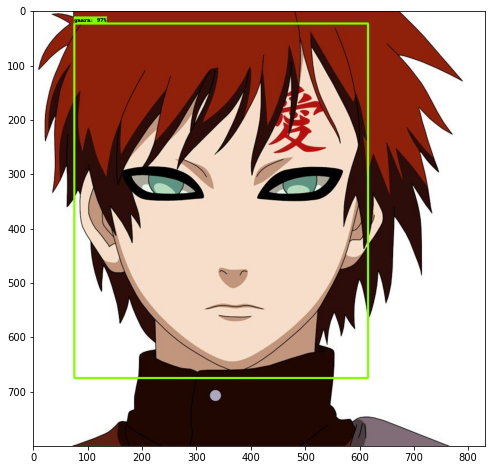

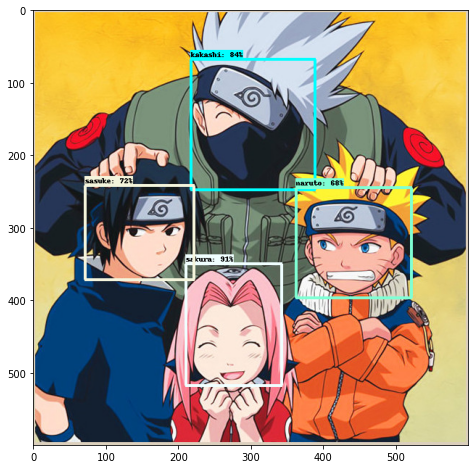

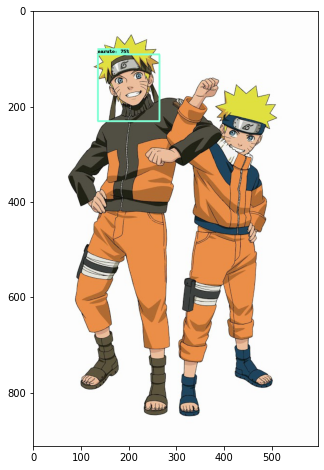

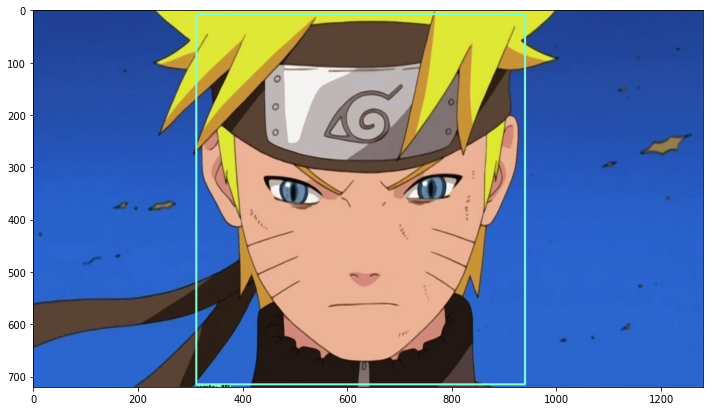

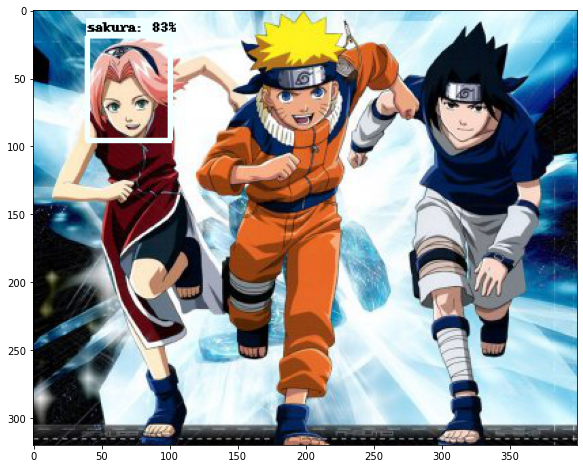

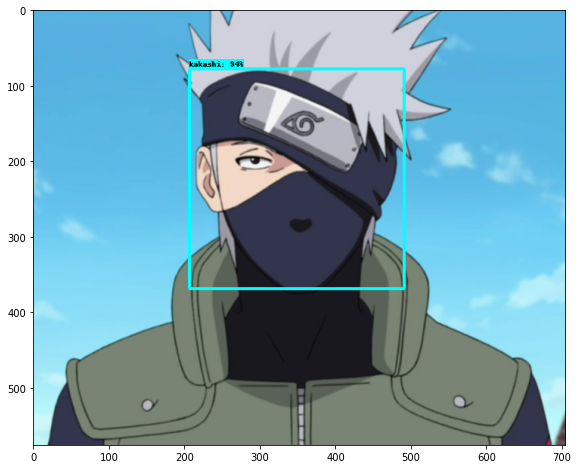

In [ ]:
run_detection(PATH_TO_CKPT)

In [ ]:
%cd /content/drive/MyDrive/ObjectDetectionAPI/example_naruto/

/content/drive/MyDrive/ObjectDetectionAPI/example_naruto


In [ ]:
!ls

annotations				   test.zip
annotations.zip				   training
exportedModel				   train.zip
generate_tfrecord.py			   unzip.ipynb
images					   xml_to_csv_test.py
ObjectDetectionAPI_Training_english.ipynb  xml_to_csv_train.py
ObjectDetectionAPI_Training.ipynb


In [ ]:
!zip -q -r exportedModel.zip exportedModel/